# Домашнее задание  № 5. Матричные разложения/Тематическое моделирование

### Задание № 1 (8 баллов)

Попробуйте матричные разложения с 4 классификаторами - SGDClassifier, KNeighborsClassifier,  RandomForest, ExtraTreesClassifier (про него подробнее почитайте в документации, он похож на RF). Используйте и NMF, SVD и LDA. Сравните результаты на кросс-валидации и выберите лучшее сочетание.

В итоге у вас должно получиться, как минимум 12 моделей (три разложения на каждый классификатор). Используйте 1 и те же параметры кросс-валидации. Параметры векторизации, параметры K в матричных разложениях, параметры классификаторов могут быть разными между экспериментами.

Можете взять поменьше данных, если все будет обучаться слишком долго (не ставьте параметр K слишком большим в NMF и LDA, иначе точно будет слишком долго)

#### Импорт библиотек и данных

In [1]:
!pip install gensim pymorphy2==0.8 seaborn pyLDAvis


[notice] A new release of pip available: 22.3.1 -> 23.3.2
[notice] To update, run: pip install --upgrade pip


In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
import gensim
import pandas as pd
import numpy as np
from pymorphy2 import MorphAnalyzer
import pyLDAvis.gensim_models
from collections import Counter
from string import punctuation
from razdel import tokenize as razdel_tokenize
from IPython.display import Image
from IPython.core.display import HTML 
from sklearn.decomposition import TruncatedSVD, NMF, PCA, LatentDirichletAllocation
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, TfidfTransformer
from sklearn.metrics.pairwise import cosine_distances
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.model_selection import KFold, StratifiedKFold
from matplotlib import pyplot as plt
import seaborn as sns

In [4]:
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import FunctionTransformer

In [5]:
morph = MorphAnalyzer()

In [6]:
# добавим лемматизацию
def normalize(text):
    normalized_text = [word.text.strip(punctuation) for word \
                                                            in razdel_tokenize(text)]
    normalized_text = [word.lower() for word in normalized_text if word and len(word) < 20 ]
    normalized_text = [morph.parse(word)[0].normal_form for word in normalized_text]
    return ' '.join(normalized_text)

In [7]:
data = pd.read_csv('avito_category_classification.csv')

In [8]:
data

,category_name,description
0,Автомобили,"отличное состояние,обслужиание в салоне"
1,Детская одежда и обувь,В отличном состоянии. Фирма KIKO. Очень теплый...
2,Предложение услуг,"Изготовление ограждений, перил,качелей, турник..."
3,Автомобили,Автомобиль в отличном техническом состоянии. О...
4,Бытовая техника,"Продается газовая плита ""Гефест"" (Белоруссия) ..."
...,...,...
9893,Товары для детей и игрушки,Чтобы посмотреть весь ассортимент нашего магаз...
9894,Детская одежда и обувь,"Весна,осень.74-80.вопросы можно в вайбер,двухс..."
9895,"Одежда, обувь, аксессуары","Кимоно Green Hill. Состояние отличное, рост ..."
9896,Детская одежда и обувь,Б/у кроссовки на девочку. Носили только в спор...


In [9]:
data['description_norm'] = data['description'].apply(normalize)

In [10]:
def eval_table(X, y, pipeline, N=6):
    # зафиксируем порядок классов
    labels = list(set(y))
    
    # метрики отдельных фолдов будет хранить в табличке
    fold_metrics = pd.DataFrame(index=labels)
    # дополнительно также соберем таблицу ошибок
    errors = np.zeros((len(labels), len(labels)))
    
    # создаем стратегию кросс-валидации
    # shuffle=True (перемешивание) - часто критично важно указать
    # т.к. данные могут быть упорядочены и модель на этом обучится
    kfold = StratifiedKFold(n_splits=N, shuffle=True, )
    
    for i, (train_index, test_index) in enumerate(kfold.split(X, y)):
        # fit-predict как и раньше, но сразу пайплайном
        pipeline.fit(X[train_index], y[train_index])
        preds = pipeline.predict(X[test_index])
        
        # записываем метрику и индекс фолда
        fold_metrics[f'precision_{i}'] = precision_score(y[test_index], preds, labels=labels, average=None)
        fold_metrics[f'recall_{i}'] = recall_score(y[test_index], preds, labels=labels, average=None)
        fold_metrics[f'f1_{i}'] = f1_score(y[test_index], preds, labels=labels, average=None)
        errors += confusion_matrix(y[test_index], preds, labels=labels, normalize='true')
    
    # таблица для усредненных значений
    # тут мы берем колонки со значениями и усредняем их
    # часто также все метрики сразу суммируют и в конце просто делят на количество фолдов
    # но мы тут помимо среднего также хотим посмотреть на стандартное отклонение
    # чтобы понять как сильно варьируются оценки моделей
    result = pd.DataFrame(index=labels)
    result['precision'] = fold_metrics[[f'precision_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['precision_std'] = fold_metrics[[f'precision_{i}' for i in range(N)]].std(axis=1).round(2)
    
    result['recall'] = fold_metrics[[f'recall_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['recall_std'] = fold_metrics[[f'recall_{i}' for i in range(N)]].std(axis=1).round(2)
    
    result['f1'] = fold_metrics[[f'f1_{i}' for i in range(N)]].mean(axis=1).round(2)
    result['f1_std'] = fold_metrics[[f'f1_{i}' for i in range(N)]].std(axis=1).round(2)
    
    # добавим одну колонку со средним по всем классам
    result.loc['mean'] = result.mean().round(2)
    # проценты ошибок просто усредняем
    errors /= N
    
    return result, errors

#### SGDClassifier

##### NMF

In [11]:
# SGDClassifier + NMF
pipeline_sgd_nmf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), min_df=2, max_df=0.5)),
    ('tfidf', TfidfTransformer()),
    ('decomposition', NMF(n_components=50)),
    ('clf', SGDClassifier(alpha=1e-4, max_iter=1000))
])
metrics_sgd_nmf, errors_sgd_nmf = eval_table(data['description_norm'], data['category_name'], pipeline_sgd_nmf)
metrics_sgd_nmf

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.78,0.05,0.98,0.01,0.87,0.03
Мебель и интерьер,0.28,0.29,0.16,0.23,0.13,0.12
Товары для детей и игрушки,0.67,0.22,0.51,0.21,0.52,0.14
Автомобили,0.78,0.12,0.81,0.07,0.79,0.04
Предложение услуг,0.59,0.14,0.58,0.12,0.56,0.04
Ремонт и строительство,0.11,0.13,0.08,0.14,0.08,0.12
Телефоны,0.68,0.08,0.65,0.10,0.66,0.03
"Одежда, обувь, аксессуары",0.61,0.04,0.72,0.06,0.66,0.01
Детская одежда и обувь,0.65,0.04,0.63,0.08,0.64,0.03
Бытовая техника,0.19,0.27,0.06,0.10,0.06,0.07


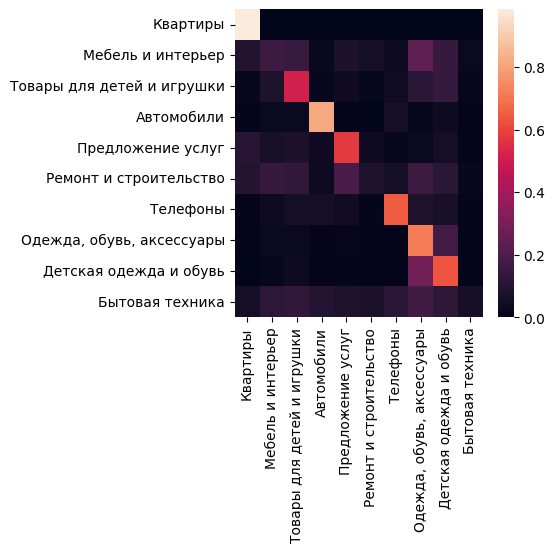

In [12]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_sgd_nmf, xticklabels=metrics_sgd_nmf.index.tolist()[:-1], 
            yticklabels=metrics_sgd_nmf.index.tolist()[:-1])
plt.show()

##### SVD

In [61]:
# SGDClassifier + TruncatedSVD
pipeline_sgd_svd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', TruncatedSVD(500)),
    ('clf', SGDClassifier(loss='hinge', penalty='l2', alpha=1e-3))
])

metrics_sgd_svd, errors_sgd_svd = eval_table(data['description_norm'], data['category_name'], pipeline_sgd_svd)
metrics_sgd_svd

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.95,0.03,0.96,0.01,0.96,0.02
Мебель и интерьер,0.69,0.06,0.65,0.07,0.67,0.06
Товары для детей и игрушки,0.76,0.03,0.65,0.05,0.70,0.03
Автомобили,0.87,0.04,0.90,0.01,0.89,0.02
Предложение услуг,0.78,0.04,0.78,0.05,0.78,0.03
Ремонт и строительство,0.68,0.07,0.47,0.06,0.55,0.04
Телефоны,0.81,0.04,0.81,0.04,0.81,0.01
"Одежда, обувь, аксессуары",0.68,0.03,0.80,0.02,0.74,0.02
Детская одежда и обувь,0.76,0.03,0.75,0.03,0.75,0.02
Бытовая техника,0.73,0.11,0.49,0.09,0.58,0.09


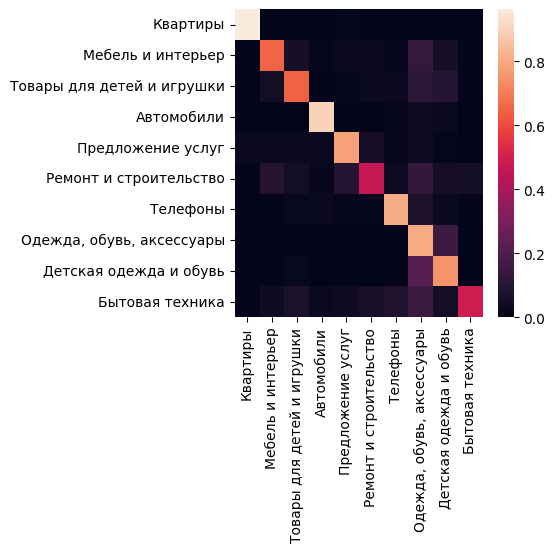

In [62]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_sgd_svd, xticklabels=metrics_sgd_svd.index.tolist()[:-1], 
            yticklabels=metrics_sgd_svd.index.tolist()[:-1])
plt.show()

##### LDA

In [26]:
# SGDClassifier + LatentDirichletAllocation
pipeline_sgd_lda = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=4, max_df=0.6)),
    ('lda', LatentDirichletAllocation(n_components=80)),
    ('clf', SGDClassifier(alpha=1e-4, max_iter=1500))
])
metrics_sgd_lda, errors_sgd_lda = eval_table(data['description_norm'], data['category_name'], pipeline_sgd_lda)
metrics_sgd_lda

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.87,0.07,0.98,0.01,0.92,0.04
Мебель и интерьер,0.45,0.16,0.17,0.13,0.22,0.15
Товары для детей и игрушки,0.65,0.05,0.47,0.07,0.54,0.05
Автомобили,0.70,0.09,0.84,0.04,0.76,0.06
Предложение услуг,0.52,0.08,0.72,0.07,0.60,0.05
Ремонт и строительство,0.32,0.01,0.14,0.11,0.17,0.11
Телефоны,0.63,0.08,0.66,0.12,0.63,0.06
"Одежда, обувь, аксессуары",0.57,0.04,0.62,0.08,0.59,0.02
Детская одежда и обувь,0.59,0.05,0.66,0.07,0.62,0.02
Бытовая техника,0.24,0.21,0.07,0.05,0.10,0.07


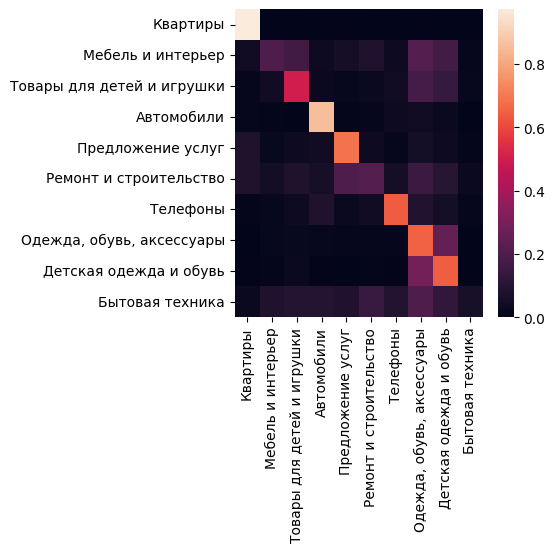

In [16]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_sgd_lda, xticklabels=metrics_sgd_lda.index.tolist()[:-1], 
            yticklabels=metrics_sgd_lda.index.tolist()[:-1])
plt.show()

#### KNeighborsClassifier

##### NMF

In [17]:
# KNeighborsClassifier + NMF
pipeline_knn_nmf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), min_df=2, max_df=0.5)),
    ('tfidf', TfidfTransformer()),
    ('decomposition', NMF(n_components=50)),
    ('clf', KNeighborsClassifier(n_neighbors=5))
])
metrics_knn_nmf, errors_knn_nmf = eval_table(data['description_norm'], data['category_name'], pipeline_knn_nmf)

In [19]:
metrics_knn_nmf

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.91,0.01,0.88,0.03,0.89,0.01
Мебель и интерьер,0.24,0.05,0.21,0.04,0.22,0.05
Товары для детей и игрушки,0.58,0.06,0.37,0.03,0.45,0.04
Автомобили,0.61,0.05,0.75,0.07,0.67,0.05
Предложение услуг,0.49,0.04,0.70,0.07,0.58,0.05
Ремонт и строительство,0.27,0.06,0.24,0.02,0.25,0.04
Телефоны,0.61,0.05,0.46,0.04,0.52,0.02
"Одежда, обувь, аксессуары",0.57,0.02,0.56,0.02,0.56,0.02
Детская одежда и обувь,0.56,0.01,0.60,0.02,0.58,0.01
Бытовая техника,0.16,0.05,0.22,0.07,0.19,0.06


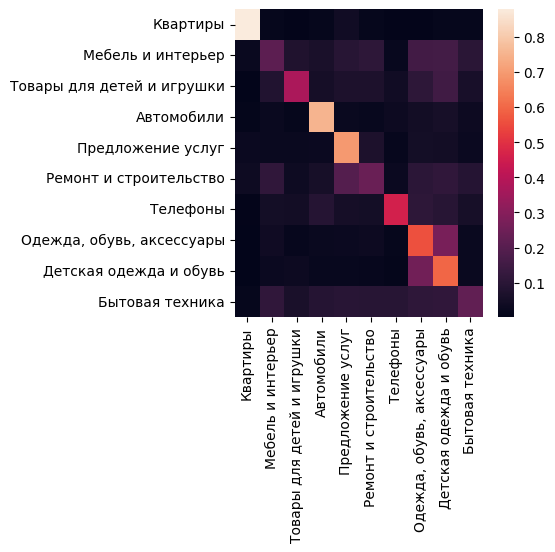

In [21]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_knn_nmf, xticklabels=metrics_knn_nmf.index.tolist()[:-1], 
            yticklabels=metrics_knn_nmf.index.tolist()[:-1])
plt.show()

##### SVD

In [22]:
# KNeighborsClassifier + TruncatedSVD
pipeline_knn_svd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=3, max_df=0.4)),
    ('svd', TruncatedSVD(n_components=300)),
    ('clf', KNeighborsClassifier(n_neighbors=3))
])
metrics_knn_svd, errors_knn_svd = eval_table(data['description_norm'], data['category_name'], pipeline_knn_svd)
metrics_knn_svd

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.89,0.04,0.77,0.01,0.82,0.02
Мебель и интерьер,0.30,0.07,0.28,0.03,0.29,0.05
Товары для детей и игрушки,0.63,0.06,0.24,0.03,0.35,0.02
Автомобили,0.50,0.04,0.68,0.06,0.57,0.04
Предложение услуг,0.57,0.06,0.51,0.05,0.54,0.05
Ремонт и строительство,0.36,0.06,0.16,0.02,0.22,0.03
Телефоны,0.80,0.09,0.30,0.04,0.43,0.04
"Одежда, обувь, аксессуары",0.50,0.01,0.55,0.02,0.52,0.01
Детская одежда и обувь,0.46,0.02,0.61,0.02,0.52,0.01
Бытовая техника,0.19,0.04,0.33,0.08,0.24,0.06


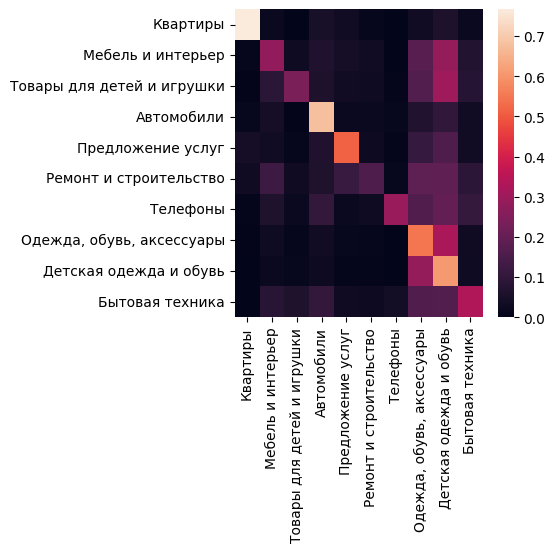

In [23]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_knn_svd, xticklabels=metrics_knn_svd.index.tolist()[:-1], 
            yticklabels=metrics_knn_svd.index.tolist()[:-1])
plt.show()


##### LDA

In [25]:
# KNeighborsClassifier + LatentDirichletAllocation
pipeline_knn_lda = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=4, max_df=0.6)),
    ('lda', LatentDirichletAllocation(n_components=80)),
    ('clf', KNeighborsClassifier(n_neighbors=5))
])
metrics_knn_lda, errors_knn_lda = eval_table(data['description_norm'], data['category_name'], pipeline_knn_lda)
metrics_knn_lda

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.91,0.03,0.94,0.03,0.92,0.02
Мебель и интерьер,0.33,0.11,0.24,0.06,0.27,0.06
Товары для детей и игрушки,0.61,0.05,0.35,0.04,0.44,0.04
Автомобили,0.63,0.08,0.83,0.03,0.72,0.05
Предложение услуг,0.66,0.07,0.57,0.07,0.61,0.06
Ремонт и строительство,0.30,0.12,0.11,0.04,0.16,0.06
Телефоны,0.64,0.13,0.50,0.08,0.56,0.07
"Одежда, обувь, аксессуары",0.52,0.02,0.48,0.04,0.50,0.03
Детская одежда и обувь,0.46,0.03,0.65,0.04,0.54,0.02
Бытовая техника,0.27,0.10,0.21,0.08,0.23,0.09


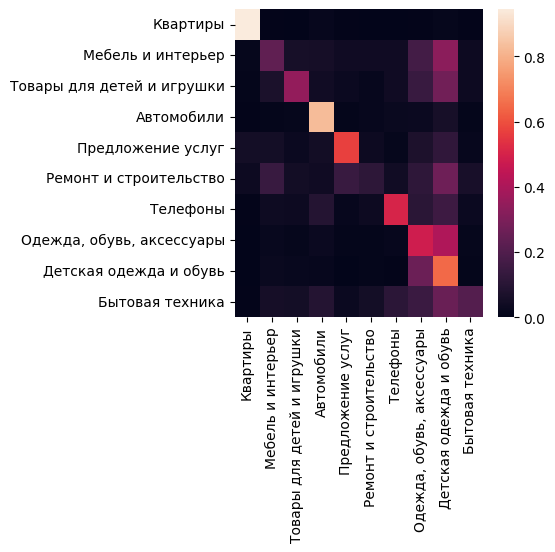

In [27]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_knn_lda, xticklabels=metrics_knn_lda.index.tolist()[:-1], 
            yticklabels=metrics_knn_lda.index.tolist()[:-1])
plt.show()

#### RandomForest

##### NMF

In [28]:
# RandomForestClassifier + NMF
pipeline_rf_nmf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), min_df=2, max_df=0.5)),
    ('tfidf', TfidfTransformer()),
    ('decomposition', NMF(n_components=50)),
    ('clf', RandomForestClassifier(n_estimators=100))
])
metrics_rf_nmf, errors_rf_nmf = eval_table(data['description_norm'], data['category_name'], pipeline_rf_nmf)
metrics_rf_nmf

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.95,0.02,0.96,0.02,0.95,0.01
Мебель и интерьер,0.60,0.07,0.49,0.06,0.54,0.06
Товары для детей и игрушки,0.70,0.03,0.59,0.03,0.64,0.03
Автомобили,0.82,0.05,0.87,0.04,0.84,0.03
Предложение услуг,0.67,0.01,0.70,0.03,0.69,0.01
Ремонт и строительство,0.51,0.08,0.39,0.06,0.44,0.07
Телефоны,0.75,0.05,0.76,0.03,0.76,0.03
"Одежда, обувь, аксессуары",0.67,0.01,0.74,0.01,0.70,0.01
Детская одежда и обувь,0.70,0.02,0.76,0.02,0.73,0.01
Бытовая техника,0.60,0.06,0.22,0.04,0.32,0.05


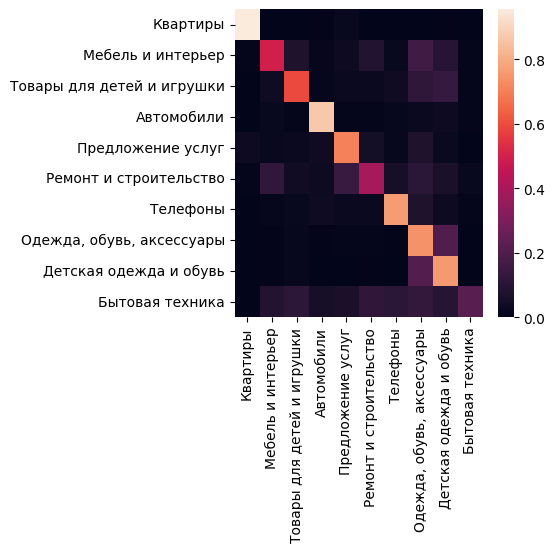

In [29]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_rf_nmf, xticklabels=metrics_rf_nmf.index.tolist()[:-1], 
            yticklabels=metrics_rf_nmf.index.tolist()[:-1])
plt.show()

##### SVD

In [30]:
# RandomForestClassifier + TruncatedSVD
pipeline_rf_svd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=3, max_df=0.4)),
    ('svd', TruncatedSVD(n_components=300)),
    ('clf', RandomForestClassifier(n_estimators=150))
])
metrics_rf_svd, errors_rf_svd = eval_table(data['description_norm'], data['category_name'], pipeline_rf_svd)
metrics_rf_svd

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.90,0.01,0.90,0.02,0.90,0.01
Мебель и интерьер,0.68,0.11,0.16,0.03,0.26,0.05
Товары для детей и игрушки,0.65,0.07,0.33,0.04,0.44,0.05
Автомобили,0.83,0.04,0.73,0.06,0.77,0.03
Предложение услуг,0.70,0.06,0.59,0.07,0.64,0.04
Ремонт и строительство,0.65,0.08,0.17,0.04,0.27,0.05
Телефоны,0.88,0.06,0.48,0.08,0.62,0.07
"Одежда, обувь, аксессуары",0.52,0.02,0.72,0.03,0.60,0.02
Детская одежда и обувь,0.50,0.01,0.71,0.01,0.58,0.01
Бытовая техника,0.70,0.09,0.14,0.03,0.22,0.04


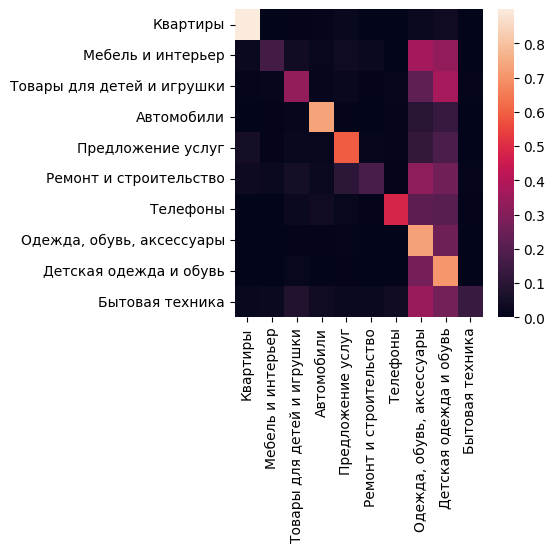

In [31]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_rf_svd, xticklabels=metrics_rf_svd.index.tolist()[:-1], 
            yticklabels=metrics_rf_svd.index.tolist()[:-1])
plt.show()

##### LDA

In [32]:
pipeline_rf_lda = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('lda', LatentDirichletAllocation(50)),
    ('clf', RandomForestClassifier())
])
metrics_rf_lda, errors_rf_lda = eval_table(data['description_norm'], data['category_name'], pipeline_rf_lda)
metrics_rf_lda

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.89,0.03,0.96,0.03,0.92,0.02
Мебель и интерьер,0.45,0.10,0.30,0.11,0.36,0.11
Товары для детей и игрушки,0.57,0.05,0.48,0.05,0.52,0.04
Автомобили,0.77,0.04,0.81,0.05,0.79,0.03
Предложение услуг,0.66,0.07,0.67,0.07,0.66,0.06
Ремонт и строительство,0.41,0.05,0.25,0.08,0.31,0.07
Телефоны,0.68,0.04,0.66,0.04,0.67,0.02
"Одежда, обувь, аксессуары",0.54,0.03,0.63,0.05,0.58,0.04
Детская одежда и обувь,0.57,0.04,0.63,0.03,0.60,0.03
Бытовая техника,0.40,0.11,0.13,0.04,0.20,0.05


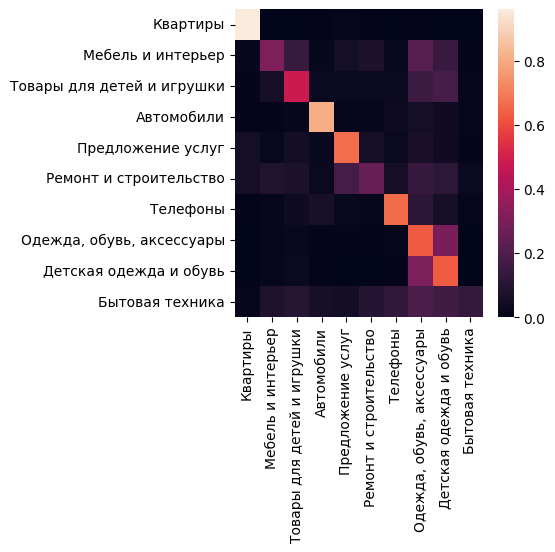

In [33]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_rf_lda, xticklabels=metrics_rf_lda.index.tolist()[:-1], 
            yticklabels=metrics_rf_lda.index.tolist()[:-1])
plt.show()


#### ExtraTreesClassifier

##### NMF

In [34]:
# ExtraTreesClassifier + NMF
pipeline_et_nmf = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), min_df=2, max_df=0.5)),
    ('tfidf', TfidfTransformer()),
    ('decomposition', NMF(n_components=50)),
    ('clf', ExtraTreesClassifier(n_estimators=100))
])
metrics_et_nmf, errors_et_nmf = eval_table(data['description_norm'], data['category_name'], pipeline_et_nmf)
metrics_et_nmf

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.93,0.02,0.96,0.01,0.95,0.01
Мебель и интерьер,0.65,0.06,0.45,0.04,0.53,0.04
Товары для детей и игрушки,0.69,0.01,0.57,0.03,0.63,0.02
Автомобили,0.83,0.03,0.89,0.03,0.86,0.03
Предложение услуг,0.68,0.02,0.75,0.03,0.71,0.01
Ремонт и строительство,0.51,0.06,0.38,0.07,0.43,0.06
Телефоны,0.75,0.06,0.75,0.03,0.75,0.04
"Одежда, обувь, аксессуары",0.66,0.02,0.75,0.02,0.70,0.01
Детская одежда и обувь,0.69,0.02,0.75,0.02,0.72,0.01
Бытовая техника,0.58,0.10,0.21,0.02,0.30,0.03


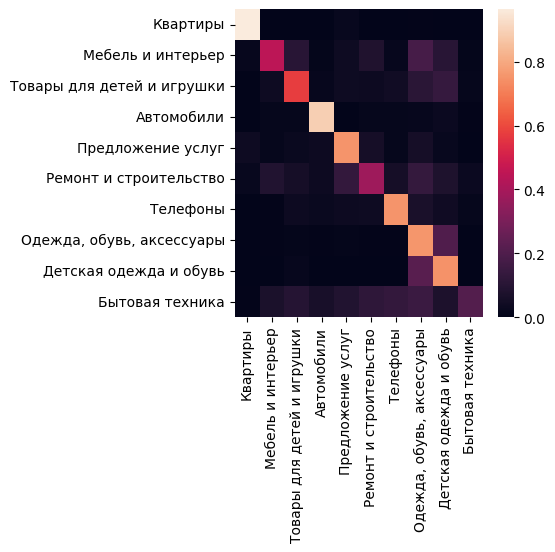

In [35]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_et_nmf, xticklabels=metrics_et_nmf.index.tolist()[:-1], 
            yticklabels=metrics_et_nmf.index.tolist()[:-1])
plt.show()

##### SVD

In [36]:
# ExtraTreesClassifier + TruncatedSVD
pipeline_et_svd = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=5, max_df=0.4)),
    ('svd', TruncatedSVD(500)),
    ('clf', ExtraTreesClassifier())
])
metrics_et_svd, errors_et_svd = eval_table(data['description_norm'], data['category_name'], pipeline_et_svd)
metrics_et_svd

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.69,0.03,0.78,0.04,0.74,0.03
Мебель и интерьер,0.74,0.14,0.12,0.03,0.21,0.05
Товары для детей и игрушки,0.66,0.06,0.17,0.04,0.27,0.04
Автомобили,0.81,0.03,0.46,0.02,0.58,0.02
Предложение услуг,0.83,0.07,0.25,0.04,0.38,0.05
Ремонт и строительство,0.61,0.12,0.09,0.02,0.16,0.03
Телефоны,0.90,0.06,0.31,0.04,0.46,0.05
"Одежда, обувь, аксессуары",0.47,0.01,0.71,0.02,0.56,0.01
Детская одежда и обувь,0.43,0.01,0.71,0.02,0.54,0.02
Бытовая техника,0.58,0.13,0.15,0.07,0.23,0.10


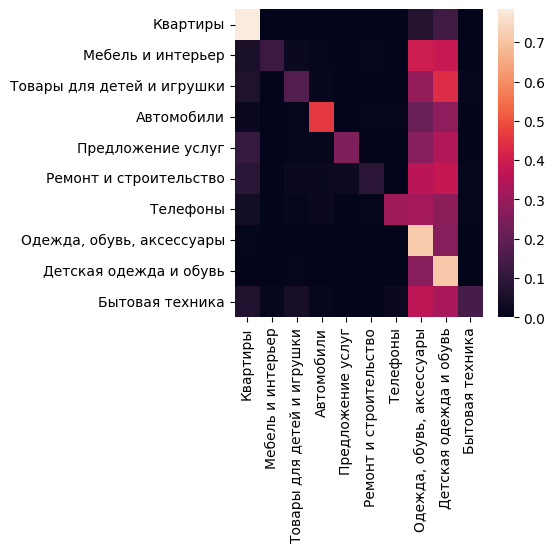

In [37]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_et_svd, xticklabels=metrics_et_svd.index.tolist()[:-1], 
            yticklabels=metrics_et_svd.index.tolist()[:-1])
plt.show()

##### LDA

In [38]:
# ExtraTreesClassifier + LatentDirichletAllocation
pipeline_et_lda = Pipeline([
    ('bow', CountVectorizer(tokenizer=lambda x: x.split(), ngram_range=(1,2), min_df=4, max_df=0.6)),
    ('lda', LatentDirichletAllocation(n_components=80)),
    ('clf', ExtraTreesClassifier(n_estimators=120))
])
metrics_et_lda, errors_et_lda = eval_table(data['description_norm'], data['category_name'], pipeline_et_lda)
metrics_et_lda

,precision,precision_std,recall,recall_std,f1,f1_std
Квартиры,0.88,0.02,0.96,0.01,0.92,0.01
Мебель и интерьер,0.45,0.10,0.26,0.09,0.33,0.10
Товары для детей и игрушки,0.60,0.03,0.47,0.04,0.52,0.03
Автомобили,0.74,0.03,0.87,0.05,0.80,0.03
Предложение услуг,0.64,0.04,0.65,0.06,0.65,0.05
Ремонт и строительство,0.40,0.06,0.23,0.08,0.29,0.08
Телефоны,0.69,0.05,0.67,0.07,0.68,0.06
"Одежда, обувь, аксессуары",0.54,0.01,0.60,0.04,0.56,0.03
Детская одежда и обувь,0.56,0.02,0.67,0.02,0.61,0.02
Бытовая техника,0.48,0.10,0.19,0.05,0.27,0.05


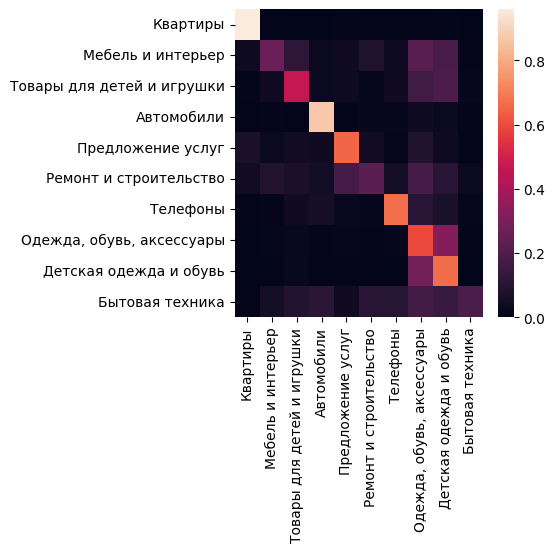

In [39]:
plt.figure(figsize=(4, 4))
sns.heatmap(errors_et_lda, xticklabels=metrics_et_lda.index.tolist()[:-1], 
            yticklabels=metrics_et_lda.index.tolist()[:-1])
plt.show()

#### Сравнение 12-ти моделей

In [67]:
# Сортировка моделей по убыванию среднего значения precision
sorted_by_precision = sorted(summary_metrics.items(), key=lambda x: x[1]['precision'], reverse=True)
print("precision:")
for model, metrics in sorted_by_precision:
    print(f"{model}: {metrics['precision']}")

# по возрастанию среднего значения precision_std
sorted_by_precision_std = sorted(summary_metrics.items(), key=lambda x: x[1]['precision_std'])
print("\nprecision_std:")
for model, metrics in sorted_by_precision_std:
    print(f"{model}: {metrics['precision_std']}")

# по убыванию среднего значения recall
sorted_by_recall = sorted(summary_metrics.items(), key=lambda x: x[1]['recall'], reverse=True)
print("\nrecall:")
for model, metrics in sorted_by_recall:
    print(f"{model}: {metrics['recall']}")

# по возрастанию среднего значения recall_std
sorted_by_recall_std = sorted(summary_metrics.items(), key=lambda x: x[1]['recall_std'])
print("\nrecall_std:")
for model, metrics in sorted_by_recall_std:
    print(f"{model}: {metrics['recall_std']}")

# по убыванию среднего значения f1
sorted_by_f1 = sorted(summary_metrics.items(), key=lambda x: x[1]['f1'], reverse=True)
print("\nf1:")
for model, metrics in sorted_by_f1:
    print(f"{model}: {metrics['f1']}")

# по возрастанию среднего значения f1_std
sorted_by_f1_std = sorted(summary_metrics.items(), key=lambda x: x[1]['f1_std'])
print("\nf1_std:")
for model, metrics in sorted_by_f1_std:
    print(f"{model}: {metrics['f1_std']}")


precision:
sgd_svd: 0.77
rf_nmf: 0.7
rf_svd: 0.7
et_nmf: 0.7
et_svd: 0.67
et_lda: 0.6
rf_lda: 0.59
sgd_lda: 0.55
sgd_nmf: 0.53
knn_lda: 0.53
knn_svd: 0.52
knn_nmf: 0.5

precision_std:
sgd_svd: 0.04
knn_nmf: 0.04
rf_nmf: 0.04
et_nmf: 0.04
knn_svd: 0.05
et_lda: 0.05
rf_svd: 0.06
rf_lda: 0.06
knn_lda: 0.07
et_svd: 0.07
sgd_lda: 0.08
sgd_nmf: 0.14

recall:
sgd_svd: 0.72
rf_nmf: 0.65
et_nmf: 0.65
et_lda: 0.56
rf_lda: 0.55
sgd_lda: 0.53
sgd_nmf: 0.52
knn_nmf: 0.5
knn_lda: 0.49
rf_svd: 0.49
knn_svd: 0.44
et_svd: 0.37

recall_std:
rf_nmf: 0.03
et_nmf: 0.03
et_svd: 0.03
sgd_svd: 0.04
knn_nmf: 0.04
knn_svd: 0.04
rf_svd: 0.04
knn_lda: 0.05
et_lda: 0.05
rf_lda: 0.06
sgd_lda: 0.08
sgd_nmf: 0.11

f1:
sgd_svd: 0.74
rf_nmf: 0.66
et_nmf: 0.66
rf_lda: 0.56
et_lda: 0.56
rf_svd: 0.53
sgd_lda: 0.52
sgd_nmf: 0.5
knn_lda: 0.5
knn_nmf: 0.49
knn_svd: 0.45
et_svd: 0.41

f1_std:
sgd_svd: 0.03
knn_svd: 0.03
rf_nmf: 0.03
et_nmf: 0.03
knn_nmf: 0.04
rf_svd: 0.04
et_svd: 0.04
knn_lda: 0.05
rf_lda: 0.05
et_lda: 0.05
s

In [69]:
# Создаем список моделей и их метрик mean
models_metrics_mean = {
    'sgd_svd': metrics_sgd_svd.loc['mean'],
    'sgd_lda': metrics_sgd_lda.loc['mean'],
    'sgd_nmf': metrics_sgd_nmf.loc['mean'],
    'rf_nmf': metrics_rf_nmf.loc['mean'],
    'rf_lda': metrics_rf_lda.loc['mean'],
    'rf_svd': metrics_rf_svd.loc['mean'],
    'et_nmf': metrics_et_nmf.loc['mean'],
    'et_svd': metrics_et_svd.loc['mean'],
    'et_lda': metrics_et_lda.loc['mean'],
    'knn_lda': metrics_knn_lda.loc['mean'],
    'knn_svd': metrics_knn_svd.loc['mean'],
    'knn_nmf': metrics_knn_nmf.loc['mean']
}

# Удаляем метрики std из каждого среза
models_metrics_mean_no_std = {model: metrics[['precision', 'recall', 'f1']] for model, metrics in models_metrics_mean.items()}

# Усредняем все метрики в строке mean для каждой модели
models_mean_averages = {model: metrics.mean() for model, metrics in models_metrics_mean_no_std.items()}

# Сортируем модели по убыванию среднего значения
sorted_models_by_mean = dict(sorted(models_mean_averages.items(), key=lambda item: item[1], reverse=True))
for model, mean_value in sorted_models_by_mean.items():
    print(f"{model}: {mean_value:.2f}")


sgd_svd: 0.75
rf_nmf: 0.67
et_nmf: 0.67
rf_svd: 0.57
et_lda: 0.57
rf_lda: 0.57
sgd_lda: 0.53
sgd_nmf: 0.52
knn_lda: 0.51
knn_nmf: 0.50
et_svd: 0.48
knn_svd: 0.47


**SGDClassifier + TruncatedSVD (sgd_svd) показывает лучшие результаты почти по всем метрикам кроме precision_std**

### Задание № 2 (2 балла)

С помощью gensim постройте 5 тематических моделей с разными параметрами. Как минимум попробуйте: разное количество тем, alpha и eta параметры (в альфа попробуйте "asymmetric" и "auto" помимо 'symmetric' по дефолту, в eta просто попробуйте разные значения), а также разные параметры фильтрации словаря. 

Оцените каждую из моделей с помощью метрик (перплексии и когерентности), а также визуально, просмотрев получаемые темы. Найдите самую хорошую тему для каждой из моделей.

In [70]:
texts = open('wiki_data.txt').read().splitlines()[:5000]
texts = ([normalize(text) for text in texts])

In [71]:
len(texts)

5000

In [89]:
dictionary = gensim.corpora.Dictionary((text.split() for text in texts))
dictionary.filter_extremes(no_above=0.1, no_below=10)
dictionary.compactify()
print(dictionary)

Dictionary<8165 unique tokens: ['1,2', '1,5', '12', '14', '16']...>


In [90]:
corpus = [dictionary.doc2bow(text.split()) for text in texts]

#### **lda_1**

(no_above=0.1, no_below=10)

(corpus, num_topics=200, id2word=dictionary, passes=50)

In [112]:
lda_1 = gensim.models.LdaModel(corpus, num_topics=200, id2word=dictionary, passes=50)
lda_1.print_topics()

[(167,
  '0.078*"n" + 0.077*"ветвь" + 0.074*"иран" + 0.072*"ядро" + 0.066*"мозг" + 0.066*"люксембург" + 0.036*"пешеходный" + 0.033*"волокно" + 0.031*"сторона" + 0.028*"али"'),
 (98,
  '0.071*"герб" + 0.064*"красный" + 0.054*"изобразить" + 0.046*"зелёный" + 0.039*"золотой" + 0.035*"цвета" + 0.034*"флаг" + 0.030*"щит" + 0.029*"верхний" + 0.028*"символ"'),
 (76,
  '0.036*"1975" + 0.033*"1980" + 0.032*"1978" + 0.031*"1972" + 0.029*"1952" + 0.028*"1969" + 0.027*"1973" + 0.027*"1974" + 0.026*"1977" + 0.026*"1967"'),
 (188,
  '0.538*"результат" + 0.146*"расследование" + 0.119*"65" + 0.050*"прочность" + 0.025*"лично" + 0.008*"неизвестный" + 0.004*"считаться" + 0.000*"убийство" + 0.000*"жертва" + 0.000*"принудительный"'),
 (144,
  '0.069*"сезон" + 0.036*"выиграть" + 0.028*"победа" + 0.025*"первое" + 0.023*"раунд" + 0.020*"смочь" + 0.019*"выйти" + 0.017*"франция" + 0.017*"круг" + 0.016*"четыре"'),
 (54,
  '0.103*"станция" + 0.075*"дорога" + 0.059*"железнодорожный" + 0.047*"железный" + 0.040*"уча

In [113]:
# Перплексия
perplexity_1 = np.exp2(-lda_1.log_perplexity(corpus[:1000]))
perplexity_1

587.2911369535485

In [114]:
# Когерентность
topics_1 = []
for topic_id, topic in lda_1.show_topics(num_topics=200, formatted=False):
    topic = [word for word, _ in topic]
    topics_1.append(topic)

coherence_model_lda_1 = gensim.models.CoherenceModel(topics=topics_1, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary, coherence='c_v')
coherence_1 = coherence_model_lda_1.get_coherence()
coherence_1

0.5480156381710818

In [115]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim_models.prepare(lda_1, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
141   -0.181267  0.042834       1        1  2.466001
159   -0.230769 -0.136499       2        1  2.433066
24    -0.192674 -0.124941       3        1  1.995170
93    -0.121934  0.136996       4        1  1.858796
100   -0.091118  0.126691       5        1  1.616943
...         ...       ...     ...      ...       ...
155    0.096977 -0.063215     196        1  0.083001
145    0.113212 -0.033013     197        1  0.082557
132    0.107783 -0.026451     198        1  0.078829
62     0.099221 -0.047318     199        1  0.076930
188    0.110894 -0.041405     200        1  0.067490

[200 rows x 5 columns], topic_info=                Term         Freq        Total  Category  logprob  loglift
117           остров  1183.000000  1183.000000   Default  30.0000  30.0000
704             уезд  1191.000000  1191.000000   Default  29.0000  29.0000
6580     житомирский   988.000000   988.000000   Default  28.0000  28.0000
1039       результат   834.000000   834.000000   Default  27.0000  27.0000
1092             сша   924.000000   924.000000   Default  26.0000  26.0000
...              ...          ...          ...       ...      ...      ...
16    альтернативный     0.005747    50.839804  Topic200 -11.2098  -1.7869
17             берег     0.005747   564.736489  Topic200 -11.2098  -4.1946
18         благодаря     0.005747   360.954005  Topic200 -11.2098  -3.7470
19          близость     0.005747    35.894877  Topic200 -11.2098  -1.4388
20     водоснабжение     0.005747    13.614215  Topic200 -11.2098  -0.4693

[9206 rows x 6 columns], token_table=      Topic      Freq Term
term                      
708       9  0.711401    0
708      14  0.156639    0
708     156  0.130532    0
6848     43  0.316077  0,5
6848    106  0.671663  0,5
...     ...       ...  ...
539     101  0.024212    №
539     110  0.012913    №
539     127  0.011299    №
539     137  0.350261    №
539     170  0.009685    №

[30816 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[142, 160, 25, 94, 101, 72, 169, 95, 81, 96, 3, 53, 10, 135, 83, 145, 73, 131, 161, 65, 128, 140, 162, 194, 114, 167, 28, 30, 185, 13, 27, 171, 51, 45, 107, 149, 111, 88, 122, 153, 183, 42, 32, 119, 195, 57, 66, 134, 190, 186, 54, 21, 172, 179, 148, 92, 144, 147, 158, 16, 77, 6, 181, 40, 19, 85, 78, 62, 12, 11, 124, 55, 154, 76, 116, 103, 173, 127, 33, 120, 130, 35, 67, 164, 174, 184, 89, 59, 29, 191, 123, 1, 152, 98, 175, 99, 74, 9, 170, 151, 2, 60, 187, 129, 126, 115, 198, 46, 24, 26, 15, 112, 97, 68, 56, 23, 4, 75, 177, 64, 132, 193, 157, 113, 14, 52, 61, 182, 93, 136, 36, 17, 163, 86, 70, 196, 58, 82, 192, 87, 47, 109, 166, 110, 84, 71, 159, 139, 50, 188, 7, 106, 39, 197, 37, 141, 38, 104, 49, 200, 69, 121, 8, 22, 20, 150, 105, 143, 48, 199, 79, 168, 41, 137, 155, 118, 102, 34, 108, 90, 178, 43, 117, 31, 100, 5, 180, 80, 44, 165, 176, 91, 125, 18, 138, 156, 146, 133, 63, 189])

#### Хорошо интерпретируемые темы на карте 1:

1. спорт – 9 (футбол), 31, 11 (олимпиада)
матч
сборный
клуб
игрок
контракт
команда
гол
чемпионат
футболист
против
сборная
перейти
забить
кубок
провести
сыграть
3. война – 4, 5, 40
армия
войско
сила
потеря
солдат
сопротивление
вооружённый
сторона
тысяча
вторжение
действие
сражение
оказаться
поддержка
командование
ход
5. внутренняя политика – 15
республика
президент
правительство
совет
министр
член
глава
пост
государственный
должность
председатель
избранный
собрание
комитет
палата
депутат
власть
губернатор
7. флот – 53
корабль
борт
экипаж
капитан
строить
авианосец
ноябрь
uss
катер
океан
контр-адмирал
вывести
берег
палуба
9. автомобиль – 46
подвеска
колесо
поперечный
поворот
продольный
ося
шина
элемент
автомобиль
ход
точка
боковой
дорога
сила
движение
например
11. ссср – 126
союз
советский
герой
1944
ныне
1943
отечественный
деревня
совет
звание
белоруссия
президиум
сержант
указ
посмертно

#### **lda_2**

(no_below=40, no_above=0.2, keep_n=5000)

(corpus_2, num_topics=150, id2word=dictionary_2, passes=25, alpha='asymmetric')

In [118]:
len(dictionary)

8165

In [126]:
dictionary_2 = gensim.corpora.Dictionary((text.split() for text in texts))
dictionary_2.filter_extremes(no_below=40, no_above=0.2, keep_n=5000)
dictionary.compactify()
# слово должно встречаться как минимум в 40 документах, чтобы оказаться в словаре
# слово будет исключено из словаря, если оно встречается в более чем 20% документов
# берем только топ 5000 частотных слов
corpus_2 = [dictionary_2.doc2bow(text.split()) for text in texts]
lda_2 = gensim.models.LdaModel(corpus_2, num_topics=150, id2word=dictionary_2, passes=25, alpha='asymmetric')

In [130]:
# Перплексия
perplexity_2 = np.exp2(-lda_2.log_perplexity(corpus_2[:1000]))
perplexity_2

230.56492631290484

In [132]:
# Когерентность
topics_2 = []
for topic_id, topic in lda_2.show_topics(num_topics=150, formatted=False):
    topic = [word for word, _ in topic]
    topics_2.append(topic)

coherence_model_lda_2 = gensim.models.CoherenceModel(topics=topics_2, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary_2, coherence='c_v')
coherence_2 = coherence_model_lda_2.get_coherence()
coherence_2

0.5919676549880687

In [127]:
lda_2.print_topics()

[(146,
  '0.501*"’" + 0.261*"s" + 0.119*"m" + 0.090*"v" + 0.005*"выпускать" + 0.002*"основатель" + 0.001*"впервые" + 0.001*"чем" + 0.001*"верный" + 0.000*"буква"'),
 (147,
  '0.058*"миллион" + 0.057*"компания" + 0.037*"доллар" + 0.033*"100" + 0.029*"группа" + 0.026*"предприятие" + 0.023*"крупный" + 0.014*"2001" + 0.013*"новый" + 0.013*"2008"'),
 (148,
  '0.122*"у" + 0.067*"вода" + 0.043*"тело" + 0.033*"внутренний" + 0.032*"орган" + 0.032*"или" + 0.028*"обладать" + 0.024*"хозяин" + 0.021*"другой" + 0.021*"наибольший"'),
 (149,
  '0.048*"книга" + 0.031*"фильм" + 0.021*"жизнь" + 0.020*"роман" + 0.014*"написать" + 0.013*"история" + 0.012*"смерть" + 0.011*"под" + 0.010*"жить" + 0.009*"работа"'),
 (142,
  '0.327*"италия" + 0.272*"итальянский" + 0.099*"рим" + 0.057*"социалистический" + 0.051*"германия" + 0.018*"франция" + 0.015*"мировой" + 0.013*"столица" + 0.012*"новое" + 0.011*"1978"'),
 (144,
  '0.254*"язык" + 0.078*"русский" + 0.050*"английский" + 0.047*"перевод" + 0.041*"слово" + 0.031*"

In [134]:
pyLDAvis.gensim_models.prepare(lda_2, corpus_2, dictionary_2)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
121   -0.286687  0.154686       1        1  4.535785
1     -0.262074  0.064327       2        1  4.501591
113   -0.205171 -0.196887       3        1  2.817714
0     -0.229881  0.142544       4        1  2.449980
71    -0.170088 -0.057077       5        1  2.146583
...         ...       ...     ...      ...       ...
110    0.095555  0.054487     146        1  0.036836
76     0.083614  0.052125     147        1  0.032465
67     0.085481  0.054048     148        1  0.032426
61     0.025217  0.042482     149        1  0.013365
37    -0.153510  0.000518     150        1  0.006315

[150 rows x 5 columns], topic_info=             Term         Freq        Total  Category  logprob  loglift
21          город  2657.000000  2657.000000   Default  30.0000  30.0000
214          игра  2182.000000  2182.000000   Default  29.0000  29.0000
104        остров  1141.000000  1141.000000   Default  28.0000  28.0000
1001      украина   874.000000   874.000000   Default  27.0000  27.0000
1548  олимпийский  1492.000000  1492.000000   Default  26.0000  26.0000
...           ...          ...          ...       ...      ...      ...
25          жилой     0.014033    96.521713  Topic150  -7.8732   0.8339
26         житель     0.014033   458.181371  Topic150  -7.8732  -0.7236
27           жить     0.014033   440.846028  Topic150  -7.8732  -0.6851
28       закрытый     0.014033    93.886404  Topic150  -7.8732   0.8615
29        запасть     0.014033    51.768019  Topic150  -7.8732   1.4569

[6613 rows x 6 columns], token_table=      Topic      Freq Term
term                      
551      19  0.102246    0
551      52  0.019171    0
551      56  0.875479    0
552       6  0.017906  000
552      29  0.026860  000
...     ...       ...  ...
432      34  0.024172    №
432      66  0.035453    №
432     120  0.003223    №
432     124  0.821865    №
432     129  0.006446    №

[22883 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[122, 2, 114, 1, 72, 57, 41, 23, 27, 150, 31, 127, 50, 94, 70, 5, 83, 141, 140, 22, 20, 26, 54, 6, 51, 28, 64, 53, 87, 99, 33, 121, 36, 90, 60, 12, 25, 30, 17, 16, 46, 13, 75, 138, 66, 91, 73, 128, 146, 103, 4, 107, 97, 148, 113, 124, 137, 89, 100, 134, 65, 115, 74, 14, 7, 10, 63, 126, 112, 102, 32, 35, 76, 82, 131, 139, 40, 55, 125, 39, 67, 52, 123, 149, 133, 145, 56, 37, 130, 58, 92, 81, 101, 24, 108, 29, 61, 104, 93, 105, 88, 85, 42, 135, 144, 43, 79, 11, 84, 49, 106, 132, 78, 80, 110, 120, 98, 48, 129, 117, 71, 109, 119, 136, 96, 8, 143, 59, 19, 45, 9, 44, 147, 142, 118, 18, 21, 34, 116, 47, 86, 95, 15, 69, 3, 111, 77, 68, 62, 38])

#### Хорошо интерпретируемые темы на карте 2:

1. военная тематика – 7,27
орден
командир
война
наградить
военный
степень
произвести
назначить
звание
получить
армия
герой
2. спорт –  14,33
турнир
финал
чемпионат
открытый
мир
рейтинг
одиночный
полуфинал
обыграть
выйти
профессиональный
4. политика – 5
партия
политический
движение
правительство
власть
президент
член
выборы
политика
страна
депутат
выбор
парламент
революционный
союз
лидер
организация
революция
палата
демократический
представитель
6. автомобили – 19
автомобиль
модель
двигатель
машина
задний
скорость
литр
получить
передний
конструктор
мощность
новый
часть
8. природа – 103
растение
воздух
или
поверхность
чистый
количество
земля
иногда
вещество
средство
образовать
следовать
среда
почва

Тут темы реже пересекаются относительно других моделей

#### **lda_3**

(no_below=40, no_above=0.2, keep_n=5000)

(corpus_2, num_topics=300, id2word=dictionary_2, passes=35, alpha='auto')


In [135]:
lda_3 = gensim.models.LdaModel(corpus_2, num_topics=300, id2word=dictionary_2, passes=35, alpha='auto')
lda_3.print_topics()

[(143,
  '0.000*"сохраниться" + 0.000*"сочинение" + 0.000*"снять" + 0.000*"собрание" + 0.000*"собственность" + 0.000*"совместно" + 0.000*"совместный" + 0.000*"согласие" + 0.000*"сообщать" + 0.000*"символ"'),
 (2,
  '0.000*"сохраниться" + 0.000*"сочинение" + 0.000*"снять" + 0.000*"собрание" + 0.000*"собственность" + 0.000*"совместно" + 0.000*"совместный" + 0.000*"согласие" + 0.000*"сообщать" + 0.000*"символ"'),
 (136,
  '0.000*"сохраниться" + 0.000*"сочинение" + 0.000*"снять" + 0.000*"собрание" + 0.000*"собственность" + 0.000*"совместно" + 0.000*"совместный" + 0.000*"согласие" + 0.000*"сообщать" + 0.000*"символ"'),
 (212,
  '0.000*"сохраниться" + 0.000*"сочинение" + 0.000*"снять" + 0.000*"собрание" + 0.000*"собственность" + 0.000*"совместно" + 0.000*"совместный" + 0.000*"согласие" + 0.000*"сообщать" + 0.000*"символ"'),
 (205,
  '0.000*"сохраниться" + 0.000*"сочинение" + 0.000*"снять" + 0.000*"собрание" + 0.000*"собственность" + 0.000*"совместно" + 0.000*"совместный" + 0.000*"согласие" +

In [136]:
# Перплексия
perplexity_3 = np.exp2(-lda_2.log_perplexity(corpus_2[:1000]))
perplexity_3

230.59303820212816

In [137]:
# Когерентность
topics_3 = []
for topic_id, topic in lda_3.show_topics(num_topics=300, formatted=False):
    topic = [word for word, _ in topic]
    topics_3.append(topic)

coherence_model_lda_3 = gensim.models.CoherenceModel(topics=topics_3, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary_2, coherence='c_v')
coherence_3 = coherence_model_lda_3.get_coherence()
coherence_3

0.5009227523615816

In [139]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim_models.prepare(lda_3, corpus_2, dictionary_2)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
297    0.312454  0.142913       1        1  3.467453
176    0.280387 -0.040409       2        1  2.546488
54     0.190605  0.136932       3        1  1.699486
275    0.234182  0.063262       4        1  1.615126
180    0.259764  0.060441       5        1  1.589921
...         ...       ...     ...      ...       ...
205    0.247819  0.111636     296        1  0.001952
10     0.247819  0.111636     297        1  0.001949
212    0.247819  0.111636     298        1  0.001946
2      0.247819  0.111636     299        1  0.001940
143    0.247819  0.111636     300        1  0.001939

[300 rows x 5 columns], topic_info=         Term         Freq        Total  Category  logprob  loglift
21      город  2642.000000  2642.000000   Default  30.0000  30.0000
110         у  1860.000000  1860.000000   Default  29.0000  29.0000
214      игра  2133.000000  2133.000000   Default  28.0000  28.0000
256     новый  1371.000000  1371.000000   Default  27.0000  27.0000
72     состав  1897.000000  1897.000000   Default  26.0000  26.0000
..        ...          ...          ...       ...      ...      ...
25      жилой     0.004309    92.598575  Topic300  -7.8732   0.8754
26     житель     0.004309   459.892734  Topic300  -7.8732  -0.7274
27       жить     0.004309   451.880468  Topic300  -7.8732  -0.7098
28   закрытый     0.004309    93.203142  Topic300  -7.8732   0.8688
29    запасть     0.004309    52.106461  Topic300  -7.8732   1.4503

[12737 rows x 6 columns], token_table=      Topic      Freq Term
term                      
551      14  0.065777    0
551      19  0.736706    0
551      43  0.124977    0
551      96  0.065777    0
552      31  0.048114  000
...     ...       ...  ...
432      24  0.065074    №
432      53  0.024213    №
432      83  0.036320    №
432      86  0.040860    №
432     220  0.802069    №

[22501 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[298, 177, 55, 276, 181, 104, 154, 145, 215, 56, 286, 164, 192, 218, 6, 223, 234, 219, 103, 179, 147, 169, 225, 72, 163, 201, 81, 120, 245, 52, 228, 47, 182, 214, 204, 178, 152, 69, 83, 259, 160, 235, 173, 74, 197, 58, 263, 143, 255, 252, 241, 109, 279, 93, 222, 167, 194, 195, 299, 162, 217, 205, 290, 231, 249, 101, 190, 20, 49, 70, 124, 33, 27, 269, 176, 246, 123, 17, 136, 295, 118, 264, 274, 273, 208, 292, 43, 220, 229, 112, 240, 13, 257, 2, 48, 291, 24, 244, 140, 94, 113, 82, 85, 196, 5, 111, 172, 185, 54, 107, 243, 251, 116, 285, 135, 29, 191, 97, 283, 161, 99, 293, 237, 12, 153, 98, 277, 76, 193, 62, 132, 159, 121, 170, 119, 89, 90, 50, 15, 126, 224, 30, 261, 128, 117, 289, 227, 35, 64, 258, 284, 188, 95, 42, 166, 221, 131, 151, 114, 8, 16, 22, 59, 41, 100, 149, 148, 45, 184, 211, 146, 209, 267, 248, 280, 268, 236, 39, 80, 61, 1, 25, 297, 141, 270, 272, 122, 202, 40, 34, 183, 26, 256, 157, 138, 66, 294, 260, 207, 108, 278, 142, 37, 230, 171, 275, 232, 31, 38, 165, 86, 46, 247, 242, 233, 180, 288, 200, 60, 189, 133, 78, 253, 155, 71, 239, 14, 210, 10, 4, 18, 282, 187, 102, 106, 158, 63, 57, 87, 281, 23, 32, 68, 125, 203, 226, 287, 212, 92, 21, 127, 250, 139, 186, 296, 36, 174, 265, 300, 115, 238, 271, 168, 150, 65, 130, 110, 262, 156, 216, 84, 7, 79, 67, 91, 129, 134, 198, 53, 77, 254, 96, 266, 44, 19, 73, 75, 9, 105, 28, 51, 199, 88, 175, 137, 206, 11, 213, 3, 144])

#### Хорошо интерпретируемые темы на карте 3:

1. даты – 9
май
сентябрь
декабрь
июнь
апрель
март
август
январь
октябрь
февраль
июль
23
10
15
13
19
21
22
2. футбол – 19
клуб
матч
контракт
футболист
гол
перейти
забить
сезон
состав
против
выступать
5. олимпийский игры – 20,59
однако
уже
чтобы
удаться
под
смочь
отказаться
получить
вернуться
так
день
ещё
7. кино – 109
сериал
эпизод
агент
девушка
становиться
самый
роман
сюжет
рассказывать
чтобы
роль
прошлое
часть
сцена
желание
зритель
рейтинг
9. искусство – 64
музей
коллекция
искусство
работа
произведение
храниться
библиотека
здание
сад
дворец
создать
век
художник
государственный
открытый
сделать
копия
кроме
город
история
зал
создание
творчество
передать
художественный
центральный
фонд
архитектура
11. география – 7
километр
метр
расположить
часть
северный
высота
север
долина
юг
южный
около
западный
самый
высокий
гора
море
крупный
территория
несколько
бере

Много стоп-слов попадают в темы

#### **lda_4**

(no_above=0.1, no_below=10)

(corpus, num_topics=250, id2word=dictionary, passes=15, eta='auto')

In [140]:
lda_4 = gensim.models.LdaModel(corpus, num_topics=250, id2word=dictionary, passes=15, eta='auto')
lda_4.print_topics()

[(162,
  '0.051*"ветвь" + 0.049*"игла" + 0.047*"лесной" + 0.037*"перо" + 0.035*"европа" + 0.031*"давид" + 0.028*"неделя" + 0.028*"мягкий" + 0.027*"луговой" + 0.023*"вокальный"'),
 (136,
  '0.154*"театр" + 0.055*"опера" + 0.036*"спектакль" + 0.036*"театральный" + 0.031*"артист" + 0.031*"музыкальный" + 0.029*"режиссёр" + 0.023*"сцена" + 0.018*"драматический" + 0.016*"певец"'),
 (163,
  '0.189*"парк" + 0.140*"национальный" + 0.101*"всемирный" + 0.083*"феликс" + 0.051*"парка" + 0.032*"юнеско" + 0.026*"михайлов" + 0.020*"панорама" + 0.018*"дракон" + 0.017*"оконечность"'),
 (78,
  '0.070*"программный" + 0.055*"разработчик" + 0.040*"обеспечение" + 0.039*"разработка" + 0.034*"игровой" + 0.030*"компьютерный" + 0.027*"канадец" + 0.027*"software" + 0.025*"браун" + 0.024*"компания"'),
 (100,
  '0.279*"турнир" + 0.105*"чемпионат" + 0.079*"открытый" + 0.044*"профессиональный" + 0.042*"финал" + 0.039*"обыграть" + 0.033*"победитель" + 0.033*"снукер" + 0.025*"игрок" + 0.023*"матч"'),
 (59,
  '0.088*"ка

In [141]:
# Перплексия
perplexity_4 = np.exp2(-lda_4.log_perplexity(corpus[:1000]))
perplexity_4

734.5834121622748

In [142]:
# Когерентность
topics_4 = []
for topic_id, topic in lda_4.show_topics(num_topics=250, formatted=False):
    topic = [word for word, _ in topic]
    topics_4.append(topic)

coherence_model_lda_4 = gensim.models.CoherenceModel(topics=topics_4, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary, coherence='c_v')
coherence_4 = coherence_model_lda_4.get_coherence()
coherence_4

0.5111523651865959

In [143]:
pyLDAvis.gensim_models.prepare(lda_4, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
34    -0.199372  0.148943       1        1  2.599322
229   -0.180033 -0.062483       2        1  2.061379
238   -0.139350 -0.076632       3        1  1.742604
112   -0.167873  0.174587       4        1  1.554468
139   -0.126482  0.224572       5        1  1.480529
...         ...       ...     ...      ...       ...
193    0.164632  0.040183     246        1  0.031560
132    0.174887  0.099917     247        1  0.008699
192    0.136852  0.131724     248        1  0.003059
228    0.136852  0.131724     249        1  0.003059
175    0.136852  0.131724     250        1  0.003059

[250 rows x 5 columns], topic_info=             Term         Freq        Total  Category  logprob  loglift
117        остров  1133.000000  1133.000000   Default  30.0000  30.0000
704          уезд  1183.000000  1183.000000   Default  29.0000  29.0000
6580  житомирский  1011.000000  1011.000000   Default  28.0000  28.0000
107         фильм   998.000000   998.000000   Default  27.0000  27.0000
1092          сша   930.000000   930.000000   Default  26.0000  26.0000
...           ...          ...          ...       ...      ...      ...
2417      катание     0.002356    32.035501  Topic250  -9.0076   0.8771
3513     массовый     0.002356   113.068805  Topic250  -9.0076  -0.3840
2161   стрелковый     0.002356   333.012251  Topic250  -9.0076  -1.4642
3131          ник     0.002356    20.157841  Topic250  -9.0076   1.3404
381           сам     0.002356   516.232858  Topic250  -9.0076  -1.9026

[11258 rows x 6 columns], token_table=      Topic      Freq Term
term                      
708       2  0.511664    0
708      24  0.045919    0
708      47  0.177115    0
708     126  0.268952    0
6848      8  0.583219  0,5
...     ...       ...  ...
539     113  0.028072    №
539     131  0.089169    №
539     137  0.021467    №
539     145  0.019815    №
539     194  0.018164    №

[39224 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[35, 230, 239, 113, 140, 224, 44, 121, 37, 68, 162, 92, 22, 132, 225, 205, 29, 216, 177, 170, 95, 245, 116, 88, 192, 142, 34, 86, 98, 198, 175, 90, 49, 195, 134, 77, 243, 215, 105, 246, 172, 210, 56, 227, 57, 221, 15, 242, 228, 27, 82, 233, 14, 219, 144, 3, 59, 107, 143, 174, 112, 148, 72, 61, 41, 74, 85, 50, 12, 169, 117, 55, 171, 207, 138, 76, 45, 152, 53, 141, 103, 2, 173, 187, 137, 109, 115, 1, 4, 180, 206, 96, 100, 199, 10, 127, 102, 202, 149, 183, 101, 75, 23, 104, 197, 249, 217, 179, 78, 185, 69, 250, 43, 155, 31, 222, 154, 204, 145, 94, 182, 97, 5, 25, 188, 218, 84, 42, 89, 240, 238, 64, 38, 241, 146, 184, 150, 165, 212, 123, 47, 67, 201, 99, 213, 129, 63, 9, 83, 178, 28, 189, 13, 208, 191, 36, 203, 81, 54, 247, 16, 151, 166, 248, 18, 139, 124, 220, 66, 118, 30, 125, 32, 237, 26, 153, 214, 79, 135, 130, 40, 128, 119, 209, 91, 186, 160, 60, 114, 120, 80, 232, 24, 73, 161, 190, 65, 181, 131, 122, 8, 164, 39, 33, 147, 223, 62, 163, 244, 106, 168, 52, 58, 231, 19, 48, 20, 136, 126, 200, 46, 110, 236, 159, 17, 111, 167, 158, 93, 235, 196, 6, 71, 108, 157, 234, 11, 87, 7, 211, 226, 21, 156, 51, 70, 194, 133, 193, 229, 176])

#### Хорошо интерпретируемые темы на карте 4:

1. образование – 65
университет
школа
образование
учебный
студент
факультет
колледж
обучение
заведение
образовательный
университетский
обучаться
наука
академия
программа
занятие
курс
среди
ректор
медицинский
студенческий
база
отделение
специальность
выпускник
преподавать
учиться
крупный
квалификация
язык
3. ссср – 75, 27, 135 (то же, что и в предыдущих)
4. война – 48, 83 (то же, что и в предыдущих)
5. награды – 104
джон
премия
награда
2002
2003
исполнитель
грэмми
категория
техас
номинация
впервые
февраль
big
1992
британский
единственный
оскар
вместе
j
энтони
сэм
престижный
1998
1969
обновит
7. аристократическая семья – 18
граф
сын
де
i
ii
смерть
дочь
графство
король
iii
герцог
жена
брат
владение
джексон
брак
титул
людовик
отец
умереть
карл
iv
ум
таблица
ребёнок
герцогство
старший
потомок
правитель
9. экспедиция на северный полюс – 69
экспедиция
полюс
судно
антарктический
скотт
полярный
команда
судный
росс
морской
плавание
собака
лёд
путь
поход
достигнуть
потерпевший
ледник
план
геологический
условие
1909
отряд
исследование
день
широта
11. автомобиль – 7 (то же, что и в предыдущих)

много узких неочевидных и хорошо интерпретируемых тем


#### **lda_5**

(no_above=0.1, no_below=10)

(corpus, num_topics=250, id2word=dictionary, passes=15, eta=0.01)

In [145]:
lda_5 = gensim.models.LdaModel(corpus, num_topics=250, id2word=dictionary, passes=15, eta=0.01)
lda_5.print_topics()

[(136,
  '0.159*"израиль" + 0.054*"иерусалим" + 0.052*"иордания" + 0.043*"военный" + 0.042*"главный" + 0.040*"еврейский" + 0.036*"израильский" + 0.021*"араб" + 0.020*"британия" + 0.018*"иордан"'),
 (219,
  '0.168*"японский" + 0.141*"япония" + 0.104*"китай" + 0.037*"здоровье" + 0.030*"китайский" + 0.030*"1932" + 0.029*"шанхай" + 0.025*"экспедиционный" + 0.020*"вред" + 0.020*"маньчжурия"'),
 (82,
  '0.108*"звук" + 0.049*"дневник" + 0.044*"чужое" + 0.043*"оренбургский" + 0.043*"замужем" + 0.042*"лингвист" + 0.036*"маркий" + 0.035*"представление" + 0.028*"слух" + 0.027*"восприятие"'),
 (130,
  '0.014*"день" + 0.008*"тем" + 0.008*"сам" + 0.008*"заявить" + 0.008*"несмотря" + 0.008*"лишь" + 0.007*"ни" + 0.006*"удаться" + 0.006*"должный" + 0.006*"поздний"'),
 (107,
  '0.085*"компания" + 0.034*"торговля" + 0.031*"товар" + 0.030*"торговый" + 0.025*"фирма" + 0.022*"антонио" + 0.019*"эдуард" + 0.017*"элизабет" + 0.015*"1853" + 0.014*"рынок"'),
 (123,
  '0.046*"корпус" + 0.034*"топливо" + 0.026*"си

In [146]:
# Перплексия
perplexity_5 = np.exp2(-lda_5.log_perplexity(corpus[:1000]))
perplexity_5

693.717912815573

In [147]:
# Когерентность
topics_5 = []
for topic_id, topic in lda_5.show_topics(num_topics=250, formatted=False):
    topic = [word for word, _ in topic]
    topics_5.append(topic)

coherence_model_lda_5 = gensim.models.CoherenceModel(topics=topics_5, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary, coherence='c_v')
coherence_5 = coherence_model_lda_5.get_coherence()
coherence_5

0.5158848481761203

In [148]:
pyLDAvis.gensim_models.prepare(lda_5, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
220   -0.174938  0.047277       1        1  2.276029
227   -0.137741 -0.222970       2        1  2.268068
130   -0.184813 -0.079499       3        1  2.234199
60    -0.147889 -0.027036       4        1  2.137880
152   -0.120039  0.031725       5        1  2.092180
...         ...       ...     ...      ...       ...
146    0.177908 -0.009450     246        1  0.040489
149    0.196960 -0.015184     247        1  0.030195
113    0.213743 -0.027075     248        1  0.018079
104    0.221518 -0.040112     249        1  0.009698
186    0.222226 -0.042724     250        1  0.007421

[250 rows x 5 columns], topic_info=              Term         Freq        Total  Category  logprob  loglift
117         остров  1208.000000  1208.000000   Default  30.0000  30.0000
704           уезд  1191.000000  1191.000000   Default  29.0000  29.0000
6580   житомирский   991.000000   991.000000   Default  28.0000  28.0000
3272        летний   807.000000   807.000000   Default  27.0000  27.0000
274            мир  1170.000000  1170.000000   Default  26.0000  26.0000
...            ...          ...          ...       ...      ...      ...
402        создать     0.004175   729.201462  Topic250  -9.3217  -2.5621
784           врач     0.004175   121.144060  Topic250  -9.3217  -0.7671
853   квалификация     0.004175   114.953457  Topic250  -9.3217  -0.7146
2953             l     0.004175    54.354549  Topic250  -9.3217   0.0344
205          всего     0.004175   595.600148  Topic250  -9.3217  -2.3597

[11199 rows x 6 columns], token_table=      Topic      Freq Term
term                      
708      17  0.193544    0
708      19  0.645146    0
708      31  0.148383    0
6848     29  0.899537  0,5
709       3  0.069438  000
...     ...       ...  ...
539     103  0.003385    №
539     130  0.022006    №
539     138  0.006771    №
539     179  0.668631    №
539     214  0.001693    №

[39688 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[221, 228, 131, 61, 153, 138, 115, 72, 4, 31, 24, 40, 158, 197, 109, 6, 208, 193, 107, 99, 183, 151, 94, 79, 173, 35, 77, 16, 170, 171, 43, 53, 41, 37, 236, 223, 78, 63, 51, 97, 152, 82, 245, 42, 248, 229, 36, 188, 242, 154, 76, 160, 3, 212, 167, 102, 32, 233, 71, 132, 215, 120, 243, 30, 136, 198, 130, 149, 101, 9, 125, 47, 230, 181, 128, 155, 194, 247, 174, 196, 93, 239, 203, 2, 206, 38, 246, 95, 235, 238, 121, 8, 240, 13, 65, 249, 165, 50, 110, 135, 185, 56, 184, 68, 85, 46, 241, 108, 27, 64, 52, 22, 199, 89, 1, 214, 90, 98, 224, 222, 88, 111, 29, 237, 21, 204, 134, 54, 106, 139, 175, 168, 55, 14, 141, 124, 182, 156, 49, 210, 10, 231, 162, 140, 57, 129, 80, 59, 164, 19, 148, 220, 119, 17, 127, 87, 70, 217, 176, 25, 225, 66, 58, 161, 144, 216, 20, 250, 23, 48, 73, 207, 166, 117, 103, 195, 218, 60, 34, 211, 201, 179, 180, 143, 45, 205, 137, 126, 234, 81, 39, 84, 5, 157, 190, 96, 11, 232, 100, 213, 227, 12, 159, 104, 122, 133, 26, 112, 202, 18, 192, 86, 69, 74, 169, 142, 178, 172, 33, 191, 62, 83, 226, 92, 7, 189, 28, 244, 15, 113, 200, 209, 75, 177, 123, 145, 67, 44, 146, 91, 118, 116, 186, 219, 163, 147, 150, 114, 105, 187])

#### Хорошо интерпретируемые темы на карте 5:

1. флот – 52 (то же, что и в предыдущих)
2. театр – 106
театр
театральный
пьеса
режиссёр
спектакль
актёр
кино
александр
драматический
искусство
телевидение
роль
студия
учиться
олег
актриса
актёрский
мастерство
сцена
4. кино – 20
фильм
роль
сериал
актёр
актриса
американский
играть
сыграть
премия
главный
сняться
сниматься
карьер
режиссёр
сша
номинация
кино
телевизионный
телесериал
6. музыка – 120
песня
сингл
нил
песнь
композиция
клип
2009
чарт
узбекский
грязь
хит
алексей
петь
музыкальный
участник
видео
автор
2010
выпустить
in
написать
альбом
is
трек
a
записать
радио
сайт
официальный
объявить
8. война – 6 (то же, что и в предыдущих)
9. криминал – 61
убийство
убитый
убийца
дом
кола
совершить
найти
преступление
вскоре
преступник
убить
банда
девочка
полиция
ребёнок
дело
жертва
мультсериал
похитить
остаться
бросить
смерть
выйти
мужчина
арестовать
тюрьма
отец
наркотик
виновный

Из-за того что топиков 250, тема "искусство" хорошо разделилось на театр, музыку, кино, тоже много мелких интерпретируемых тем

#### **lda_6**

(no_below=5, no_above=0.4, keep_n=3000)

(corpus_6, num_topics=150, id2word=dictionary_6, passes=25, alpha='asymmetric')

In [149]:
dictionary_6 = gensim.corpora.Dictionary((text.split() for text in texts))
dictionary_6.filter_extremes(no_below=5, no_above=0.4, keep_n=3000)
dictionary.compactify()
# слово должно встречаться как минимум в 5 документах, чтобы оказаться в словаре
# слово будет исключено из словаря, если оно встречается в более чем 40% документов
# берем только топ 3000 частотных слов
corpus_6 = [dictionary_6.doc2bow(text.split()) for text in texts]
lda_6 = gensim.models.LdaModel(corpus_6, num_topics=150, id2word=dictionary_6, passes=25, alpha='asymmetric')
lda_6.print_topics()

[(149,
  '0.082*"литр" + 0.071*"двигатель" + 0.044*"v" + 0.035*"для" + 0.031*"зимой" + 0.030*"класс" + 0.029*"мощность" + 0.026*"летом" + 0.024*"температура" + 0.023*"°c"'),
 (148,
  '0.645*"преимущественно" + 0.150*"академик" + 0.053*"звание" + 0.041*"критик" + 0.000*"андрей" + 0.000*"он" + 0.000*"писатель" + 0.000*"академия" + 0.000*"1972" + 0.000*"портрет"'),
 (147,
  '0.185*"канада" + 0.100*"британский" + 0.096*"канадский" + 0.055*"великобритания" + 0.037*"премьер-министр" + 0.028*"провинция" + 0.028*"страна" + 0.024*"королевский" + 0.018*"лондон" + 0.016*"а"'),
 (145,
  '0.148*"мост" + 0.065*"монголия" + 0.057*"работа" + 0.035*"два" + 0.030*"рубль" + 0.028*"проект" + 0.027*"к" + 0.021*"берег" + 0.020*"выполнить" + 0.017*"метр"'),
 (142,
  '0.522*"брат" + 0.207*"ян" + 0.059*"св" + 0.028*"одиннадцать" + 0.017*"возраст" + 0.013*"август" + 0.013*"прямо" + 0.012*"дело" + 0.011*"5" + 0.009*"месяц"'),
 (146,
  '0.072*"а" + 0.050*"роман" + 0.048*"метр" + 0.043*"плата" + 0.043*"издательств

In [150]:
# Перплексия
perplexity_6 = np.exp2(-lda_6.log_perplexity(corpus_6[:1000]))
perplexity_6

194.51158149813037

In [151]:
# Когерентность
topics_6 = []
for topic_id, topic in lda_6.show_topics(num_topics=300, formatted=False):
    topic = [word for word, _ in topic]
    topics_6.append(topic)

coherence_model_lda_6 = gensim.models.CoherenceModel(topics=topics_6, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary_6, coherence='c_v')
coherence_6 = coherence_model_lda_6.get_coherence()
coherence_6

0.5410653171267271

In [152]:
pyLDAvis.gensim_models.prepare(lda_6, corpus_6, dictionary_6)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
112   -0.273476 -0.115248       1        1  7.505535
101   -0.262690 -0.107448       2        1  6.032682
111   -0.232304 -0.081304       3        1  3.293255
69    -0.193351 -0.039045       4        1  3.266397
55    -0.236458 -0.132355       5        1  3.064142
...         ...       ...     ...      ...       ...
128    0.084279 -0.228812     146        1  0.011284
16    -0.068889 -0.291058     147        1  0.009019
23    -0.068889 -0.291058     148        1  0.007228
49    -0.068889 -0.291058     149        1  0.004159
80    -0.068889 -0.291058     150        1  0.002762

[150 rows x 5 columns], topic_info=       Term          Freq         Total  Category  logprob  loglift
303      он  10064.000000  10064.000000   Default  30.0000  30.0000
679  группа   1323.000000   1323.000000   Default  29.0000  29.0000
455      за   3951.000000   3951.000000   Default  28.0000  28.0000
247    игра   2124.000000   2124.000000   Default  27.0000  27.0000
533     она   2131.000000   2131.000000   Default  26.0000  26.0000
..      ...           ...           ...       ...      ...      ...
7      1995      0.006582    224.994186  Topic150  -8.0064   0.0576
8      2012      0.006582    309.918311  Topic150  -8.0064  -0.2626
9        24      0.006582    339.049715  Topic150  -8.0064  -0.3524
10       43      0.006582     40.392323  Topic150  -8.0064   1.7751
11        6      0.006582    837.261476  Topic150  -8.0064  -1.2564

[6900 rows x 6 columns], token_table=      Topic      Freq Term
term                      
612       4  0.032208    0
612      12  0.676369    0
612      26  0.090183    0
612      31  0.186807    0
612     105  0.012883    0
...     ...       ...  ...
485      69  0.008184    №
485      71  0.027824    №
485      79  0.018004    №
485      83  0.009820    №
485     112  0.006547    №

[21778 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[113, 102, 112, 70, 56, 141, 116, 115, 10, 43, 74, 20, 89, 3, 130, 137, 52, 140, 86, 84, 106, 21, 9, 51, 100, 36, 22, 5, 2, 34, 38, 73, 65, 126, 93, 63, 47, 23, 103, 117, 6, 97, 29, 8, 83, 122, 128, 138, 27, 94, 48, 105, 71, 11, 12, 147, 25, 26, 111, 121, 28, 133, 96, 64, 101, 18, 42, 41, 104, 68, 15, 7, 1, 45, 107, 53, 132, 72, 31, 33, 119, 98, 44, 148, 79, 123, 146, 150, 80, 134, 16, 92, 145, 139, 118, 78, 39, 32, 99, 142, 30, 13, 67, 60, 35, 136, 87, 127, 95, 135, 125, 82, 109, 131, 54, 75, 62, 66, 114, 88, 37, 4, 19, 49, 57, 55, 58, 61, 120, 46, 90, 14, 76, 144, 143, 40, 108, 69, 77, 124, 85, 149, 110, 91, 59, 129, 17, 24, 50, 81])

#### Хорошо интерпретируемые темы на карте 6:

1. наука – 39
научный
исследование
институт
работа
наука
изучение
учёный
рана
теория
физика
а
сотрудник
метод
вопрос
система
директор
являться
область
проблема
лаборатория
направление
национальный
академик
отдел
эксперимент
ф
международный
российский
провести
центр
3. месяцы и даты – 19
декабрь
октябрь
май
июнь
апрель
сентябрь
ноябрь
июль
август
февраль
март
январь
10
19
26
5. территориальное деление страны – 22, 51, 33, 66, 46
район
область
состав
город
округа
территория
переименовать
образовать
округ
административный
вновь
центр
до
от
войти
статус
автономный
образование
7. ссср – 81 (то же, что и в предыдущих)
9. политика – 41 (то же, что и в предыдущих)

Кажется, тут интерпретируемо расположение тем на карте: стоп-слова оказались слева в одном месте, населенные пунткы сверху.

#### **lda_7**

(no_below=5, no_above=0.4, keep_n=3000)

(corpus_6, num_topics=150, id2word=dictionary_6, passes=25, alpha='asymmetric', eta=0.05)

In [153]:
lda_7 = gensim.models.LdaModel(corpus_6, num_topics=150, id2word=dictionary_6, passes=25, alpha='asymmetric', eta=0.05)
lda_7.print_topics()

[(148,
  '0.230*"линейный" + 0.076*"окрестность" + 0.041*"математика" + 0.026*"назвать" + 0.026*"друг" + 0.019*"честь" + 0.014*"замена" + 0.013*"точка" + 0.007*"записать" + 0.000*"черняховский"'),
 (149,
  '0.307*"италия" + 0.257*"итальянский" + 0.098*"рим" + 0.047*"турин" + 0.032*"папа" + 0.021*"римский" + 0.015*"1870" + 0.009*"область" + 0.009*"1861" + 0.009*"де"'),
 (146,
  '0.097*"1975" + 0.083*"1980" + 0.082*"1973" + 0.068*"1967" + 0.066*"1987" + 0.064*"1982" + 0.063*"1965" + 0.059*"1985" + 0.055*"1969" + 0.053*"1986"'),
 (147,
  '0.140*"книга" + 0.126*"русский" + 0.060*"язык" + 0.051*"издание" + 0.046*"литература" + 0.040*"перевод" + 0.038*"автор" + 0.037*"сборник" + 0.028*"издать" + 0.027*"история"'),
 (142,
  '0.340*"слой" + 0.000*"ружинский" + 0.000*"4138" + 0.000*"печать" + 0.000*"собирать" + 0.000*"кандидат" + 0.000*"покрыть" + 0.000*"обратный" + 0.000*"будущий" + 0.000*"анализ"'),
 (145,
  '0.288*"экспедиция" + 0.074*"эксперимент" + 0.046*"исследование" + 0.036*"экипаж" + 0

In [154]:
# Перплексия
perplexity_7 = np.exp2(-lda_7.log_perplexity(corpus_6[:1000]))
perplexity_7

191.01048443751

In [155]:
# Когерентность
topics_7 = []
for topic_id, topic in lda_7.show_topics(num_topics=300, formatted=False):
    topic = [word for word, _ in topic]
    topics_7.append(topic)

coherence_model_lda_7 = gensim.models.CoherenceModel(topics=topics_7, 
                                                   texts=[text.split() for text in texts], 
                                                   dictionary=dictionary_6, coherence='c_v')
coherence_7 = coherence_model_lda_7.get_coherence()
coherence_7

0.5242273174187466

In [157]:
pyLDAvis.gensim_models.prepare(lda_7, corpus_6, dictionary_6)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
137   -0.134234  0.241652       1        1  6.290297
84    -0.129857  0.219352       2        1  4.003224
28    -0.154602  0.171123       3        1  3.783556
8     -0.167065  0.219033       4        1  3.116268
121   -0.157619  0.172709       5        1  3.041799
...         ...       ...     ...      ...       ...
27     0.179993  0.114452     146        1  0.006491
56     0.179993  0.114452     147        1  0.003733
61     0.179993  0.114452     148        1  0.003478
101    0.180656  0.114210     149        1  0.002524
96     0.179993  0.114452     150        1  0.002354

[150 rows x 5 columns], topic_info=        Term         Freq         Total  Category  logprob  loglift
303       он  10000.00000  10000.000000   Default  30.0000  30.0000
88    состав   1838.00000   1838.000000   Default  29.0000  29.0000
123      для   4488.00000   4488.000000   Default  28.0000  28.0000
26     город   2561.00000   2561.000000   Default  27.0000  27.0000
484  человек   2266.00000   2266.000000   Default  26.0000  26.0000
..       ...          ...           ...       ...      ...      ...
25       где      0.00561   1437.932510  Topic150  -8.0064  -1.7972
26     город      0.00561   2561.836782  Topic150  -8.0064  -2.3748
27    данные      0.00561    292.263770  Topic150  -8.0064  -0.2039
28    дорога      0.00561    527.059567  Topic150  -8.0064  -0.7936
29   дорогой      0.00561     61.233921  Topic150  -8.0064   1.3590

[6966 rows x 6 columns], token_table=      Topic      Freq Term
term                      
612       2  0.036884    0
612       3  0.012295    0
612      19  0.024590    0
612      20  0.024590    0
612      35  0.768423    0
...     ...       ...  ...
485      70  0.004999    №
485      71  0.014996    №
485      76  0.006665    №
485      86  0.054986    №
485      91  0.024994    №

[23947 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[138, 85, 29, 9, 122, 44, 121, 18, 1, 81, 76, 129, 98, 103, 110, 79, 52, 70, 36, 141, 23, 65, 47, 33, 19, 32, 134, 27, 60, 24, 67, 75, 92, 133, 7, 59, 135, 119, 89, 140, 12, 108, 43, 74, 68, 104, 78, 139, 56, 101, 112, 41, 95, 38, 144, 40, 21, 111, 73, 48, 120, 2, 136, 80, 14, 26, 30, 148, 131, 94, 35, 63, 39, 45, 15, 77, 53, 105, 123, 113, 4, 124, 117, 145, 61, 17, 34, 147, 51, 20, 25, 132, 118, 115, 37, 91, 69, 46, 107, 106, 3, 150, 96, 83, 88, 146, 90, 71, 128, 114, 22, 93, 137, 11, 116, 109, 8, 72, 54, 49, 127, 42, 58, 64, 31, 55, 13, 84, 6, 100, 130, 86, 125, 149, 50, 5, 87, 126, 142, 82, 143, 66, 10, 16, 99, 28, 57, 62, 102, 97])

#### Хорошо интерпретируемые темы на карте 7:

1. церковь – 51 (оказалась внутри кружка ссср – 22)
церковь
святой
храм
епархия
епископ
православный
собор
монастырь
русский
церковный
приход
павел
духовный
религиозный
католический
день
иоанн
священник
папа
память
архиепископ
кафедра
честь
весь
област
3. даты – 23 (то же)
4. Азия – 82
китай
японский
китайский
япония
f
ли
стать
провинция
корея
для
также
инцидент

#### **Оценка моделей**

In [159]:
perplexity_values = [perplexity_1, perplexity_2, perplexity_3, perplexity_4, perplexity_5, perplexity_6, perplexity_7]
coherence_values = [coherence_1, coherence_2, coherence_3, coherence_4, coherence_5, coherence_6, coherence_7]

# Сортировка perplexity от меньшего к большему
sorted_perplexity = sorted(zip(perplexity_values, range(1, 8)))

# Сортировка coherence от большего к меньшему
sorted_coherence = sorted(zip(coherence_values, range(1, 8)), reverse=True)

# Вывод отсортированных значений
print("Перплексия моделей от лучшей к худшей")
for perplexity, model_num in sorted_perplexity:
    print(f"Model {model_num}: {perplexity}")

print("\nКогерентность моделей от лучшей к худшей")
for coherence, model_num in sorted_coherence:
    print(f"Model {model_num}: {coherence}")

Перплексия моделей от лучшей к худшей
Model 7: 191.01048443751
Model 6: 194.51158149813037
Model 2: 230.56492631290484
Model 3: 230.59303820212816
Model 1: 587.2911369535485
Model 5: 693.717912815573
Model 4: 734.5834121622748

Когерентность моделей от лучшей к худшей
Model 2: 0.5919676549880687
Model 1: 0.5480156381710818
Model 6: 0.5410653171267271
Model 7: 0.5242273174187466
Model 5: 0.5158848481761203
Model 4: 0.5111523651865959
Model 3: 0.5009227523615816
